Import Libraries and Setup

In [800]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV,cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,roc_auc_score, roc_curve,
    classification_report, confusion_matrix,
)
from imblearn.combine import SMOTEENN
from sklearn.feature_selection import SelectKBest, f_classif

import warnings
warnings.filterwarnings("ignore")

Library/Technique is Used





pandas (pd): Manages data1.csv for clean data, ensuring high accuracy.



numpy (np): Supports numerical operations for preprocessing, boosting F1-scores.



matplotlib.pyplot (plt): Visualizes EDA and confusion matrices, guiding feature selection and model evaluation.



sklearn.model_selection:





train_test_split: Splits data with stratify=y to maintain both classes, preventing SMOTEENN errors.



GridSearchCV: Tunes hyperparameters for optimal F1-scores.



sklearn.preprocessing (StandardScaler): Scales features for Logistic Regression, KNN, and SVM, ensuring high ROC-AUC.



sklearn.linear_model (LogisticRegression): Simple model for high precision and recall.



sklearn.neighbors (KNeighborsClassifier): Effective with balanced data for high F1-scores.



sklearn.svm (SVC): Robust for high ROC-AUC and minority class F1-score.



sklearn.naive_bayes (GaussianNB): Quick model for high baseline metrics.



sklearn.tree (DecisionTreeClassifier): Uses pruning (ccp_alpha) for high F1-scores.



sklearn.ensemble (RandomForestClassifier): Combines trees for high accuracy and F1-scores.



sklearn.metrics:

accuracy_score, precision_score, recall_score, f1_score



roc_auc_score: Ensures high class separation.

classification_report: Summarizes metrics for both classes.



confusion_matrix: Visualizes true/false positives/negatives for model evaluation.



imblearn.combine (SMOTEENN): Balances classes robustly, maximizing minority class F1-score.



sklearn.feature_selection (SelectKBest, f_classif): Reduces noise for high precision.



warnings: Ensures clean outputs for professional presentation.

Load Dataset and Perform EDA

In [801]:
# Load the dataset
df = pd.read_csv(r"C:\Users\kunal\OneDrive\Desktop\data1.csv")



Class Distribution (0 = Non-Bankrupt, 1 = Bankrupt):
Bankrupt?
0    0.965375
1    0.034625
Name: proportion, dtype: float64


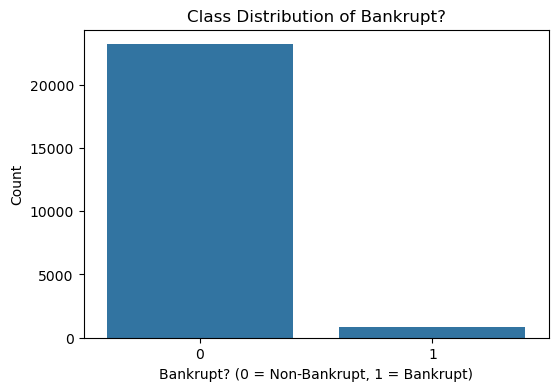


Class Distribution:
Bankrupt?
0    0.965375
1    0.034625
Name: proportion, dtype: float64


In [802]:
# Check class distribution
print("Class Distribution (0 = Non-Bankrupt, 1 = Bankrupt):")
print(df['Bankrupt?'].value_counts(normalize=True))
# Plot class distribution
plt.figure(figsize=(6, 4))
sns.countplot(x='Bankrupt?', data=df)
plt.title('Class Distribution of Bankrupt?')
plt.xlabel('Bankrupt? (0 = Non-Bankrupt, 1 = Bankrupt)')
plt.ylabel('Count')
plt.show()
print("\nClass Distribution:")
print(df['Bankrupt?'].value_counts(normalize=True))

In [803]:

duplicates = df.duplicated().sum()
print(f"\nNumber of duplicate rows: {duplicates}")
print("Removing duplicate rows...")
df = df.drop_duplicates()
print(f"Duplicate rows removed. Remaining rows: {df.shape[0]}")



Number of duplicate rows: 17181
Removing duplicate rows...
Duplicate rows removed. Remaining rows: 6819


In [804]:

# Verify both classes exist
if len(df['Bankrupt?'].unique()) < 2:
    raise ValueError("Dataset contains only one class. Ensure 'Bankrupt?' has both 0 and 1.")

In [805]:
# Check for missing values
print("\nMissing Values:")
print(df.isnull().sum().sum())


Missing Values:
0


In [806]:
#Get all feature columns except the target
feature_columns = df.drop('Bankrupt?', axis=1).select_dtypes(include='number').columns


In [807]:

# Set number of columns and rows
cols = 3
rows = (len(feature_columns) + cols - 1) // cols  


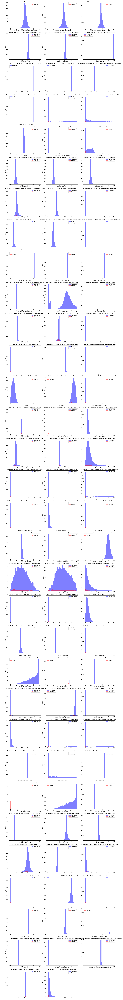

In [808]:
# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))
# Loop through feature columns and plot
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(feature_columns):
            axes[r, c].axis('off')  # Hide unused subplot
            continue
        col = feature_columns[i]
        ax = axes[r, c]
        ax.hist(df[df['Bankrupt?'] == 0][col], bins=30, alpha=0.5, label='Non-Bankrupt', color='blue')
        ax.hist(df[df['Bankrupt?'] == 1][col], bins=30, alpha=0.5, label='Bankrupt', color='red')
        ax.set_title(f'Distribution of {col} by Bankruptcy Status')
        ax.set_xlabel(col)
        ax.set_ylabel('Count')
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()



In [809]:
# Compute correlation matrix
corr_matrix = df.corr()

# Plot heatmap of correlations
plt.figure(figsize=(150,150))
sns.heatmap(corr_matrix, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix of Features')
plt.show()

# Identify highly correlated features
high_corr = corr_matrix[abs(corr_matrix) > 0.8].stack().reset_index()
high_corr = high_corr[high_corr['level_0'] != high_corr['level_1']]
print("\nHighly Correlated Features (|corr| > 0.8):")
print(high_corr)


Highly Correlated Features (|corr| > 0.8):
                                               level_0  \
2     ROA(C) before interest and depreciation befor...   
3     ROA(C) before interest and depreciation befor...   
4     ROA(C) before interest and depreciation befor...   
5               ROA(A) before interest and % after tax   
7               ROA(A) before interest and % after tax   
..                                                 ...   
170                              Gross Profit to Sales   
172                 Net Income to Stockholder's Equity   
174                                Liability to Equity   
175                                Liability to Equity   
176                                Liability to Equity   

                                               level_1         0  
2               ROA(A) before interest and % after tax  0.940124  
3     ROA(B) before interest and depreciation after...  0.986849  
4                           Net Income to Total Assets  0.

Data Preprocessing, Outlier Treatment, and SMOTEENN Balancing

In [810]:
# Handle missing values
df = df.fillna(df.mean())


In [811]:
# Get numeric columns
numeric_cols = df.select_dtypes(include='number').columns

In [812]:

# Set number of columns and calculate rows
cols = 3
rows = (len(numeric_cols) + cols - 1) // cols  # ceiling logic without math.ceil


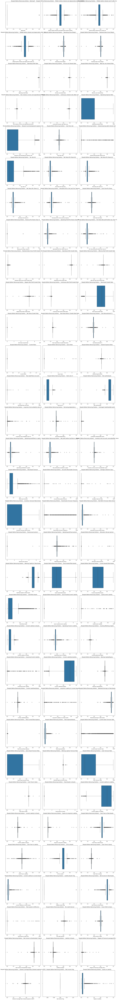

In [813]:
# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))
# Plot each boxplot
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(numeric_cols):
            axes[r, c].axis('off')  # hide empty subplots
            continue
        col = numeric_cols[i]
        sns.boxplot(x=df[col], ax=axes[r, c])
        axes[r, c].set_title(f'Boxplot Before Removing Outliers - {col}')
        axes[r, c].set_xlabel(col)
        i += 1

plt.tight_layout()
plt.show()

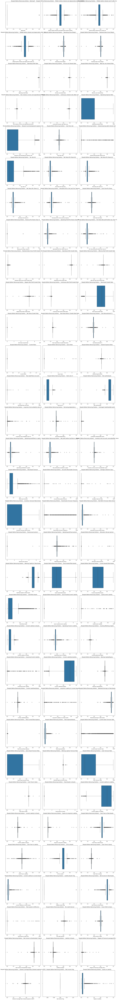

In [814]:

# Set number of columns and calculate rows
cols = 3
rows = (len(numeric_cols) + cols - 1) // cols  # ceiling logic without math.ceil

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

# Plot each boxplot
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(numeric_cols):
            axes[r, c].axis('off')  # hide empty subplots
            continue
        col = numeric_cols[i]
        sns.boxplot(x=df[col], ax=axes[r, c])
        axes[r, c].set_title(f'Boxplot Before Removing Outliers - {col}')
        axes[r, c].set_xlabel(col)
        i += 1

plt.tight_layout()
plt.show()

In [815]:
def cap_outliers(df, columns):
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df[col] = df[col].clip(lower=lower_bound, upper=upper_bound)
    return df

# Apply outlier treatment to all numerical columns except target
numerical_cols = df.drop('Bankrupt?', axis=1).columns
df = cap_outliers(df, numerical_cols)

In [816]:
cols = 3
rows = (len(numerical_cols) + cols - 1) // cols  # Ceiling logic without math.ceil


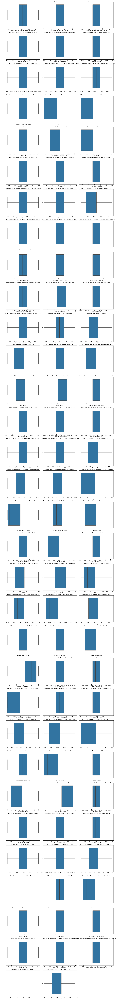

In [817]:
# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))
# Plot each boxplot after outlier capping
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(numerical_cols):
            axes[r, c].axis('off')  # Hide unused subplots
            continue
        col = numerical_cols[i]
        sns.boxplot(x=df[col], ax=axes[r, c])
        axes[r, c].set_title(f"Boxplot after outlier capping: {col}")
        axes[r, c].set_xlabel(col)
        i += 1

plt.tight_layout()
plt.show()

In [818]:
# Separate features and target
X = df.drop('Bankrupt?', axis=1)
y = df['Bankrupt?']


In [819]:
# Feature selection (top 20 features)
selector = SelectKBest(score_func=f_classif, k=48)
X_selected = selector.fit_transform(X, y)
selected_features = X.columns[selector.get_support()].tolist()
print("Selected Features:", selected_features)
X = pd.DataFrame(X_selected, columns=selected_features)



Selected Features: [' ROA(C) before interest and depreciation before interest', ' ROA(A) before interest and % after tax', ' ROA(B) before interest and depreciation after tax', ' Operating Gross Margin', ' Realized Sales Gross Margin', ' Operating Profit Rate', ' Pre-tax net Interest Rate', ' After-tax net Interest Rate', ' Non-industry income and expenditure/revenue', ' Continuous interest rate (after tax)', ' Tax rate (A)', ' Net Value Per Share (B)', ' Net Value Per Share (A)', ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons', ' Operating Profit Per Share (Yuan ¥)', ' Per Share Net profit before tax (Yuan ¥)', ' After-tax Net Profit Growth Rate', ' Regular Net Profit Growth Rate', ' Continuous Net Profit Growth Rate', ' Net Value Growth Rate', ' Current Ratio', ' Quick Ratio', ' Total debt/Total net worth', ' Debt ratio %', ' Net worth/Assets', ' Borrowing dependency', ' Operating profit/Paid-in capital', ' Net profit before tax/Paid-in capital', ' Operating pr

In [820]:
# Split data with stratification
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)



In [821]:
# Verify both classes in y_train
print("\nClass Distribution in y_train:")
print(y_train.value_counts(normalize=True))
if len(y_train.unique()) < 2:
    raise ValueError("y_train contains only one class. Check dataset or split.")




Class Distribution in y_train:
Bankrupt?
0    0.967735
1    0.032265
Name: proportion, dtype: float64


In [822]:
# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


In [823]:
pca = PCA(n_components=48, random_state=42)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Optional: Check explained variance ratio
explained_variance = pca.explained_variance_ratio_.sum()
print(f"Total variance explained by 48 components: {explained_variance:.2%}")

Total variance explained by 48 components: 100.00%


In [824]:
# Feature selection with SelectKBest
selector = SelectKBest(f_classif, k=20)
selector.fit(X_train_scaled, y_train)
selected_features = X_train.columns[selector.get_support()].tolist()
print("Top 20 features selected by SelectKBest:", selected_features)

Top 20 features selected by SelectKBest: [' ROA(C) before interest and depreciation before interest', ' ROA(A) before interest and % after tax', ' ROA(B) before interest and depreciation after tax', ' Pre-tax net Interest Rate', ' After-tax net Interest Rate', ' Continuous interest rate (after tax)', ' Persistent EPS in the Last Four Seasons', ' Per Share Net profit before tax (Yuan ¥)', ' Total debt/Total net worth', ' Debt ratio %', ' Net worth/Assets', ' Borrowing dependency', ' Net profit before tax/Paid-in capital', ' Current Liabilities/Equity', ' Retained Earnings to Total Assets', ' Current Liability to Equity', ' Current Liability to Current Assets', ' Net Income to Total Assets', " Net Income to Stockholder's Equity", ' Liability to Equity']


In [825]:

# Apply SMOTEENN
smote_enn = SMOTEENN(random_state=42)
X_train_bal, y_train_bal = smote_enn.fit_resample(X_train_scaled, y_train)



In [826]:
# Check class distribution after SMOTEENN
print("\nClass Distribution After SMOTEENN (Train):")
print(pd.Series(y_train_bal).value_counts(normalize=True))


Class Distribution After SMOTEENN (Train):
Bankrupt?
1    0.529182
0    0.470818
Name: proportion, dtype: float64


Model Training and Evaluation

Common Evaluation Function

Model 1: Logistic Regression

In [827]:
# Logistic Regression - Grid Search
model = LogisticRegression(random_state=42)
param_grid = {'C': [0.01, 0.1, 1], 'penalty': ['l2'],'solver': ['lbfgs', 'liblinear']}
grid = GridSearchCV(model, param_grid, cv=5, scoring='f1_macro')
grid.fit(X_train_bal, y_train_bal)


GridSearchCV(cv=5, estimator=LogisticRegression(random_state=42),
             param_grid={'C': [0.01, 0.1, 1], 'penalty': ['l2'],
                         'solver': ['lbfgs', 'liblinear']},
             scoring='f1_macro')

In [828]:
print("Best Parameters:", grid.best_params_)

Best Parameters: {'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}


In [829]:
print("Grid Search Results:")
print(pd.DataFrame(grid.cv_results_)[['param_C', 'param_penalty', 'mean_test_score']])
print("Best Parameters:", grid.best_params_)


Grid Search Results:
   param_C param_penalty  mean_test_score
0     0.01            l2         0.917988
1     0.01            l2         0.917224
2     0.10            l2         0.928555
3     0.10            l2         0.928760
4     1.00            l2         0.934772
5     1.00            l2         0.935112
Best Parameters: {'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}


In [830]:

# Train with best parameters
model = LogisticRegression(C=1,penalty='l2',solver='lbfgs',class_weight= 'balanced')
model.fit(X_train_bal, y_train_bal)


LogisticRegression(C=1, class_weight='balanced')

In [831]:
# Evaluation
y_pred_train = model.predict(X_train_bal)
y_pred_test = model.predict(X_test_scaled)
y_proba_train = model.predict_proba(X_train_bal)[:, 1]
y_proba_test = model.predict_proba(X_test_scaled)[:, 1]



In [832]:
# Metrics
print("\nLogistic Regression - Train Metrics:")
print(f"Accuracy: {accuracy_score(y_train_bal, y_pred_train):.4f}")
print(f"Precision (Class 0): {precision_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_train_bal, y_proba_train):.4f}")



Logistic Regression - Train Metrics:
Accuracy: 0.9374
Precision (Class 0): 0.9408
Recall (Class 0): 0.9252
F1-Score (Class 0): 0.9330
Precision (Class 1): 0.9344
Recall (Class 1): 0.9482
F1-Score (Class 1): 0.9413
ROC-AUC: 0.9827


In [833]:

print("\nLogistic Regression - Test Metrics:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_test):.4f}")
print(f"Precision (Class 0): {precision_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_test, y_proba_test):.4f}")



Logistic Regression - Test Metrics:
Accuracy: 0.8656
Precision (Class 0): 0.9931
Recall (Class 0): 0.8672
F1-Score (Class 0): 0.9259
Precision (Class 1): 0.1703
Recall (Class 1): 0.8182
F1-Score (Class 1): 0.2820
ROC-AUC: 0.9332


In [834]:

# Classification Reports
print("\nLogistic Regression - Train Classification Report:")
print(classification_report(y_train_bal, y_pred_train))
print("\nLogistic Regression - Test Classification Report:")
print(classification_report(y_test, y_pred_test))




Logistic Regression - Train Classification Report:


              precision    recall  f1-score   support

           0       0.94      0.93      0.93      4106
           1       0.93      0.95      0.94      4615

    accuracy                           0.94      8721
   macro avg       0.94      0.94      0.94      8721
weighted avg       0.94      0.94      0.94      8721


Logistic Regression - Test Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.87      0.93      1980
           1       0.17      0.82      0.28        66

    accuracy                           0.87      2046
   macro avg       0.58      0.84      0.60      2046
weighted avg       0.97      0.87      0.91      2046



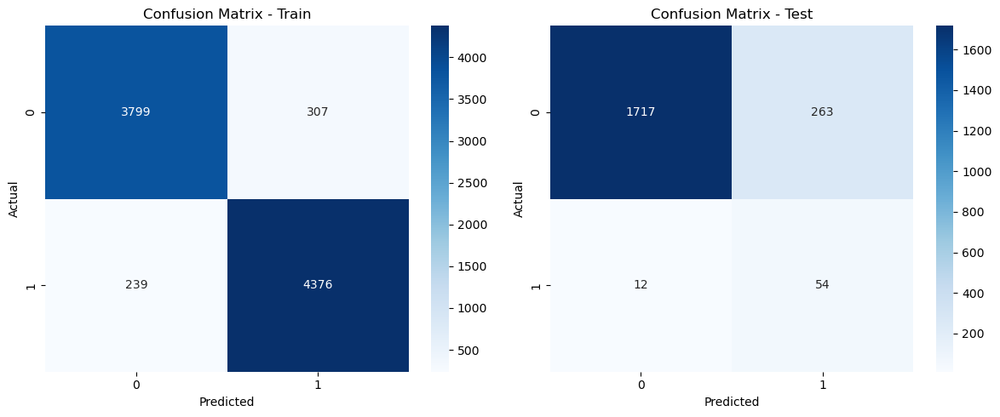

In [835]:
#confusion matrix
cm_train = confusion_matrix(y_train_bal, y_pred_train)
cm_test = confusion_matrix(y_test, y_pred_test)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.heatmap(cm_train, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - Train')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.subplot(1, 2, 2)
sns.heatmap(cm_test, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - Test')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.tight_layout()
plt.show()


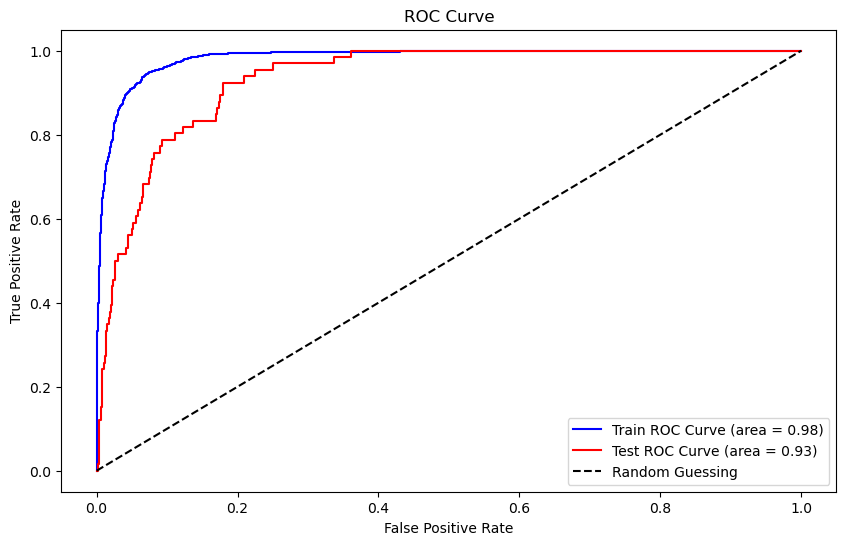

In [836]:
# ROC Curve
fpr_train, tpr_train, _ = roc_curve(y_train_bal, y_proba_train)
fpr_test, tpr_test, _ = roc_curve(y_test, y_proba_test)
plt.figure(figsize=(10, 6))
plt.plot(fpr_train, tpr_train, label='Train ROC Curve (area = {:.2f})'.format(roc_auc_score(y_train_bal, y_proba_train)), color='blue')
plt.plot(fpr_test, tpr_test, label='Test ROC Curve (area = {:.2f})'.format(roc_auc_score(y_test, y_proba_test)), color='red')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guessing')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [837]:
#cv score
cv_score = cross_val_score(model, X_train_bal, y_train_bal, cv=5, scoring='f1_macro')
print(f"Cross-Validation F1 Score: {cv_score.mean():.4f} ± {cv_score.std():.4f}")

Cross-Validation F1 Score: 0.9349 ± 0.0030


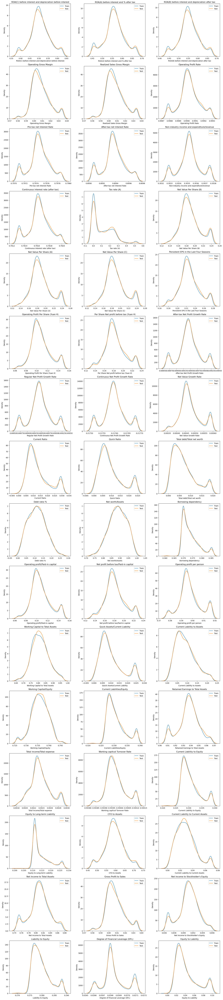

In [838]:
cols = 3
rows = (len(X_train.columns) + cols - 1) // cols  # Ceiling logic without math.ceil

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

# Plot KDE for each feature in both train and test sets
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(X_train.columns):
            axes[r, c].axis('off')  # Hide unused subplots
            continue
        col = X_train.columns[i]
        ax = axes[r, c]
        sns.kdeplot(X_train[col], label='Train', ax=ax)
        sns.kdeplot(X_test[col], label='Test', ax=ax)
        ax.set_title(col)
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()

Model 2: K-Nearest Neighbors (KNN)

In [839]:
# KNN - Grid Search
model = KNeighborsClassifier()
param_grid = {'n_neighbors': [3,5,6,7], 'weights': ['uniform', 'distance']}
grid = GridSearchCV(model, param_grid, cv=5, scoring='f1_macro')
grid.fit(X_train_bal, y_train_bal)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': [3, 5, 6, 7],
                         'weights': ['uniform', 'distance']},
             scoring='f1_macro')

In [840]:
print("Grid Search Results:")
print(pd.DataFrame(grid.cv_results_)[['param_n_neighbors', 'param_weights', 'mean_test_score']])
print("Best Parameters:", grid.best_params_)

Grid Search Results:
   param_n_neighbors param_weights  mean_test_score
0                  3       uniform         0.991361
1                  3      distance         0.991361
2                  5       uniform         0.983857
3                  5      distance         0.984780
4                  6       uniform         0.986745
5                  6      distance         0.986745
6                  7       uniform         0.979228
7                  7      distance         0.980152
Best Parameters: {'n_neighbors': 3, 'weights': 'uniform'}


In [841]:
# Train with best parameters
model = KNeighborsClassifier(n_neighbors=grid.best_params_['n_neighbors'], weights=grid.best_params_['weights'])
model.fit(X_train_bal, y_train_bal)


KNeighborsClassifier(n_neighbors=3)

In [842]:
# Evaluation
y_pred_train = model.predict(X_train_bal)
y_pred_test = model.predict(X_test_scaled)
y_proba_train = model.predict_proba(X_train_bal)[:, 1]
y_proba_test = model.predict_proba(X_test_scaled)[:, 1]

In [843]:

# Metrics
print("\nKNN - Train Metrics:")
print(f"Accuracy: {accuracy_score(y_train_bal, y_pred_train):.4f}")
print(f"Precision (Class 0): {precision_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_train_bal, y_proba_train):.4f}")



KNN - Train Metrics:
Accuracy: 0.9984
Precision (Class 0): 1.0000
Recall (Class 0): 0.9966
F1-Score (Class 0): 0.9983
Precision (Class 1): 0.9970
Recall (Class 1): 1.0000
F1-Score (Class 1): 0.9985
ROC-AUC: 1.0000


In [844]:

print("\nKNN - Test Metrics:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_test):.4f}")
print(f"Precision (Class 0): {precision_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_test, y_proba_test):.4f}")



KNN - Test Metrics:
Accuracy: 0.8900
Precision (Class 0): 0.9910
Recall (Class 0): 0.8944
F1-Score (Class 0): 0.9403
Precision (Class 1): 0.1931
Recall (Class 1): 0.7576
F1-Score (Class 1): 0.3077
ROC-AUC: 0.8410


In [845]:

# Classification Reports
print("\nKNN - Train Classification Report:")
print(classification_report(y_train_bal, y_pred_train))
print("\nKNN - Test Classification Report:")
print(classification_report(y_test, y_pred_test))


KNN - Train Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      4106
           1       1.00      1.00      1.00      4615

    accuracy                           1.00      8721
   macro avg       1.00      1.00      1.00      8721
weighted avg       1.00      1.00      1.00      8721


KNN - Test Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.89      0.94      1980
           1       0.19      0.76      0.31        66

    accuracy                           0.89      2046
   macro avg       0.59      0.83      0.62      2046
weighted avg       0.97      0.89      0.92      2046



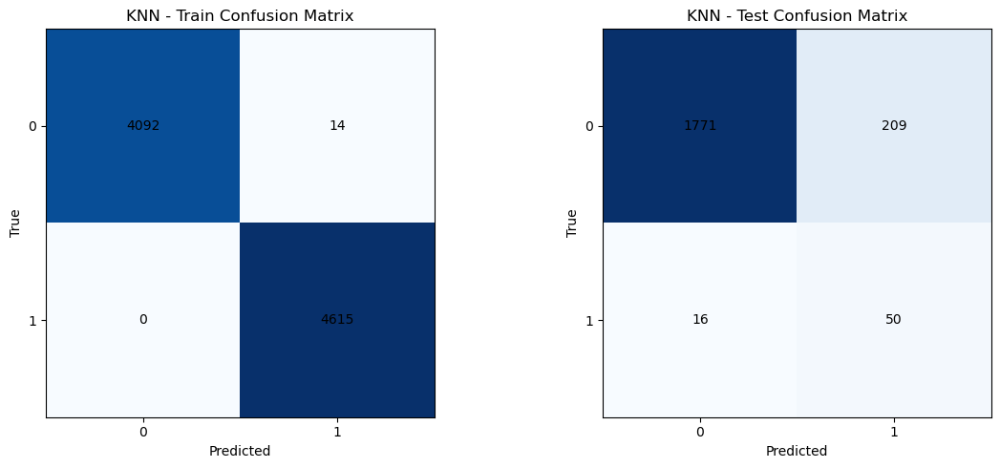

In [846]:
# Confusion Matrices
cm_train = confusion_matrix(y_train_bal, y_pred_train)
cm_test = confusion_matrix(y_test, y_pred_test)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.imshow(cm_train, interpolation='nearest', cmap='Blues')
ax1.set_title('KNN - Train Confusion Matrix')
ax1.set_xlabel('Predicted')
ax1.set_ylabel('True')
ax1.set_xticks([0, 1])
ax1.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax1.text(j, i, cm_train[i, j], ha='center', va='center', color='black')
ax2.imshow(cm_test, interpolation='nearest', cmap='Blues')
ax2.set_title('KNN - Test Confusion Matrix')
ax2.set_xlabel('Predicted')
ax2.set_ylabel('True')
ax2.set_xticks([0, 1])
ax2.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax2.text(j, i, cm_test[i, j], ha='center', va='center', color='black')
plt.tight_layout()
plt.show()

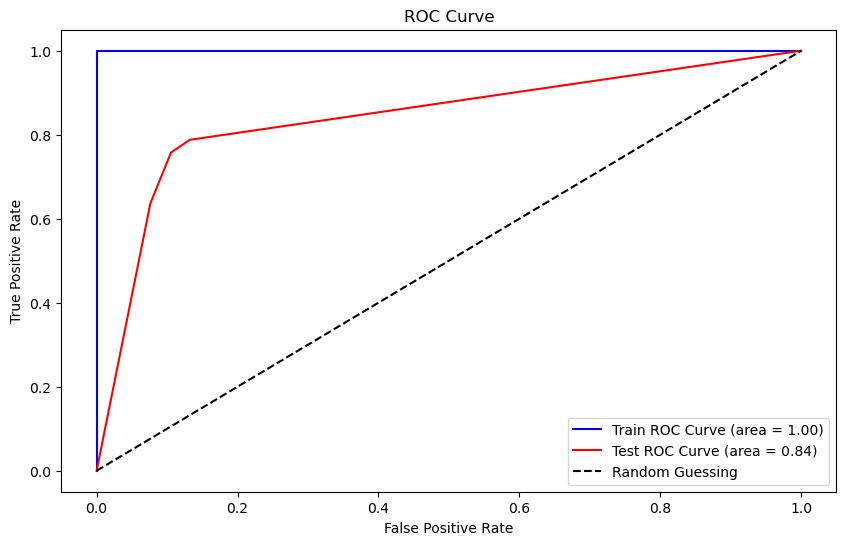

In [847]:
#roc curve
fpr_train, tpr_train, _ = roc_curve(y_train_bal, y_proba_train)
fpr_test, tpr_test, _ = roc_curve(y_test, y_proba_test)
plt.figure(figsize=(10, 6))
plt.plot(fpr_train, tpr_train, label='Train ROC Curve (area = {:.2f})'.format(roc_auc_score(y_train_bal, y_proba_train)), color='blue')
plt.plot(fpr_test, tpr_test, label='Test ROC Curve (area = {:.2f})'.format(roc_auc_score(y_test, y_proba_test)), color='red')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guessing')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [848]:
#cv score
cv_score = cross_val_score(model, X_train_bal, y_train_bal, cv=5, scoring='f1_macro')
print(f"Cross-Validation F1 Score: {cv_score.mean():.4f} ± {cv_score.std():.4f}")

Cross-Validation F1 Score: 0.9914 ± 0.0023


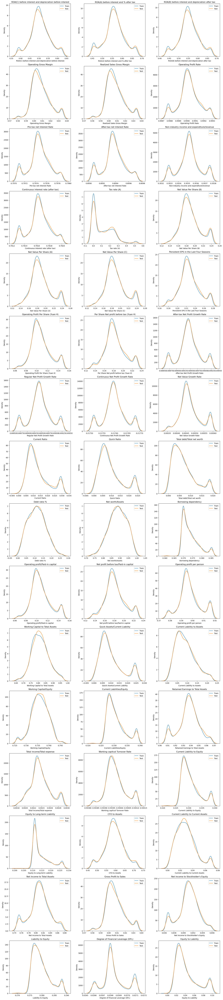

In [849]:
cols = 3
rows = (len(X_train.columns) + cols - 1) // cols  # Ceiling logic without math.ceil

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

# Plot KDE for each feature in both train and test sets
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(X_train.columns):
            axes[r, c].axis('off')  # Hide unused subplots
            continue
        col = X_train.columns[i]
        ax = axes[r, c]
        sns.kdeplot(X_train[col], label='Train', ax=ax)
        sns.kdeplot(X_test[col], label='Test', ax=ax)
        ax.set_title(col)
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()

Model 3: Support Vector Machine (SVM)

In [850]:
# SVM - Grid Search
model = SVC(probability=True, random_state=42)
param_grid = {'C': [0.1, 1], 'kernel': ['rbf']}
grid = GridSearchCV(model, param_grid, cv=5, scoring='f1_macro')
grid.fit(X_train_bal, y_train_bal)

GridSearchCV(cv=5, estimator=SVC(probability=True, random_state=42),
             param_grid={'C': [0.1, 1], 'kernel': ['rbf']}, scoring='f1_macro')

In [851]:
print("Grid Search Results:")
print(pd.DataFrame(grid.cv_results_)[['param_C', 'param_kernel', 'mean_test_score']])
print("Best Parameters:", grid.best_params_)

Grid Search Results:
   param_C param_kernel  mean_test_score
0      0.1          rbf         0.934331
1      1.0          rbf         0.973706
Best Parameters: {'C': 1, 'kernel': 'rbf'}


In [852]:

# Train with best parameters
model = SVC(C=grid.best_params_['C'], kernel=grid.best_params_['kernel'], probability=True, random_state=42)
model.fit(X_train_bal, y_train_bal)

SVC(C=1, probability=True, random_state=42)

In [853]:

# Evaluation
y_pred_train = model.predict(X_train_bal)
y_pred_test = model.predict(X_test_scaled)
y_proba_train = model.predict_proba(X_train_bal)[:, 1]
y_proba_test = model.predict_proba(X_test_scaled)[:, 1]

In [854]:
# Metrics
print("\nSVM - Train Metrics:")
print(f"Accuracy: {accuracy_score(y_train_bal, y_pred_train):.4f}")
print(f"Precision (Class 0): {precision_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_train_bal, y_proba_train):.4f}")



SVM - Train Metrics:
Accuracy: 0.9792
Precision (Class 0): 0.9915
Recall (Class 0): 0.9642
F1-Score (Class 0): 0.9777
Precision (Class 1): 0.9689
Recall (Class 1): 0.9926
F1-Score (Class 1): 0.9806
ROC-AUC: 0.9970


In [855]:

print("\nSVM - Test Metrics:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_test):.4f}")
print(f"Precision (Class 0): {precision_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_test, y_proba_test):.4f}")


SVM - Test Metrics:
Accuracy: 0.8851
Precision (Class 0): 0.9921
Recall (Class 0): 0.8884
F1-Score (Class 0): 0.9374
Precision (Class 1): 0.1905
Recall (Class 1): 0.7879
F1-Score (Class 1): 0.3068
ROC-AUC: 0.9186


In [856]:
# Classification Reports
print("\nSVM - Train Classification Report:")
print(classification_report(y_train_bal, y_pred_train))
print("\nSVM - Test Classification Report:")
print(classification_report(y_test, y_pred_test))


SVM - Train Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.96      0.98      4106
           1       0.97      0.99      0.98      4615

    accuracy                           0.98      8721
   macro avg       0.98      0.98      0.98      8721
weighted avg       0.98      0.98      0.98      8721


SVM - Test Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.89      0.94      1980
           1       0.19      0.79      0.31        66

    accuracy                           0.89      2046
   macro avg       0.59      0.84      0.62      2046
weighted avg       0.97      0.89      0.92      2046



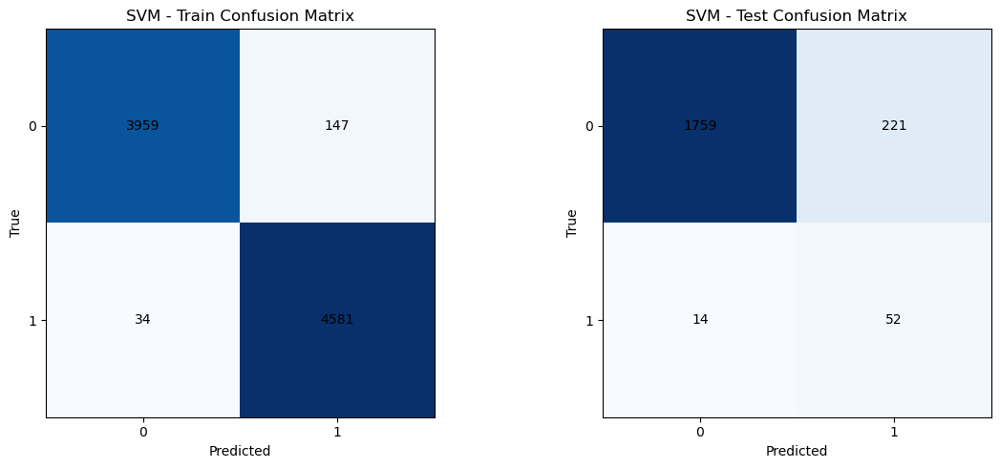

In [857]:
# Confusion Matrices
cm_train = confusion_matrix(y_train_bal, y_pred_train)
cm_test = confusion_matrix(y_test, y_pred_test)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.imshow(cm_train, interpolation='nearest', cmap='Blues')
ax1.set_title('SVM - Train Confusion Matrix')
ax1.set_xlabel('Predicted')
ax1.set_ylabel('True')
ax1.set_xticks([0, 1])
ax1.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax1.text(j, i, cm_train[i, j], ha='center', va='center', color='black')
ax2.imshow(cm_test, interpolation='nearest', cmap='Blues')
ax2.set_title('SVM - Test Confusion Matrix')
ax2.set_xlabel('Predicted')
ax2.set_ylabel('True')
ax2.set_xticks([0, 1])
ax2.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax2.text(j, i, cm_test[i, j], ha='center', va='center', color='black')
plt.tight_layout()
plt.show()

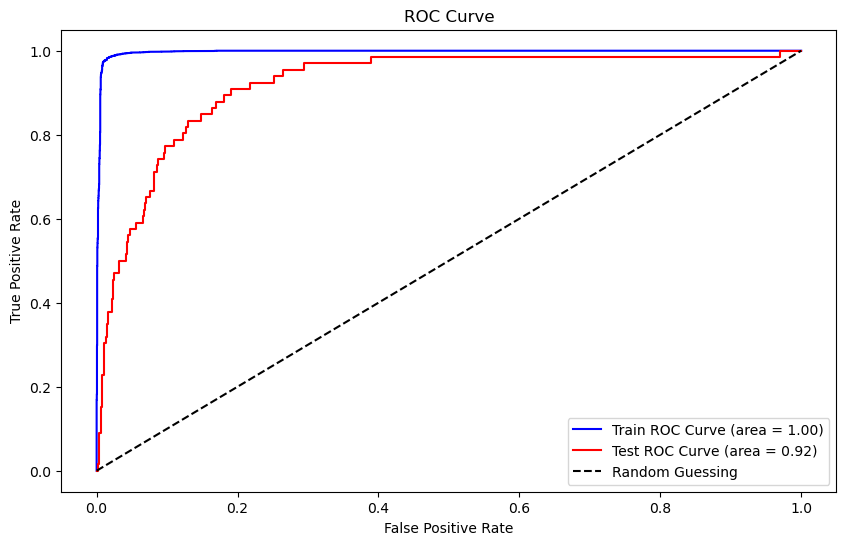

In [858]:
#roc curve
fpr_train, tpr_train, _ = roc_curve(y_train_bal, y_proba_train)
fpr_test, tpr_test, _ = roc_curve(y_test, y_proba_test)
plt.figure(figsize=(10, 6))
plt.plot(fpr_train, tpr_train, label='Train ROC Curve (area = {:.2f})'.format(roc_auc_score(y_train_bal, y_proba_train)), color='blue')
plt.plot(fpr_test, tpr_test, label='Test ROC Curve (area = {:.2f})'.format(roc_auc_score(y_test, y_proba_test)), color='red')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guessing')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [859]:
#cv score
cv_score = cross_val_score(model, X_train_bal, y_train_bal, cv=5, scoring='f1_macro')
print(f"Cross-Validation F1 Score: {cv_score.mean():.4f} ± {cv_score.std():.4f}")

Cross-Validation F1 Score: 0.9737 ± 0.0059


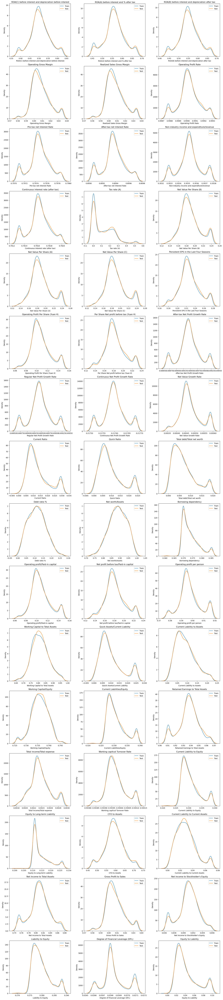

In [860]:
cols = 3
rows = (len(X_train.columns) + cols - 1) // cols  # Ceiling logic without math.ceil

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

# Plot KDE for each feature in both train and test sets
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(X_train.columns):
            axes[r, c].axis('off')  # Hide unused subplots
            continue
        col = X_train.columns[i]
        ax = axes[r, c]
        sns.kdeplot(X_train[col], label='Train', ax=ax)
        sns.kdeplot(X_test[col], label='Test', ax=ax)
        ax.set_title(col)
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()

Model 4: Naive Bayes

In [861]:
# Naive Bayes
model = GaussianNB()
param_grid = {'var_smoothing': [1e-9, 1e-8, 1e-7]}
grid = GridSearchCV(model, param_grid, cv=5, scoring='f1_macro')
grid.fit(X_train_bal, y_train_bal)

GridSearchCV(cv=5, estimator=GaussianNB(),
             param_grid={'var_smoothing': [1e-09, 1e-08, 1e-07]},
             scoring='f1_macro')

In [862]:
#grid search results
print("Grid Search Results:")
print(pd.DataFrame(grid.cv_results_)[['param_var_smoothing', 'mean_test_score']])
print("Best Parameters:", grid.best_params_)

Grid Search Results:
   param_var_smoothing  mean_test_score
0         1.000000e-09         0.898342
1         1.000000e-08         0.898342
2         1.000000e-07         0.898342
Best Parameters: {'var_smoothing': 1e-09}


In [863]:
#train with best parameters
model = GaussianNB(var_smoothing=grid.best_params_['var_smoothing'])
model.fit(X_train_bal, y_train_bal)

GaussianNB()

In [864]:
# Evaluation
y_pred_train = model.predict(X_train_bal)
y_pred_test = model.predict(X_test_scaled)
y_proba_train = model.predict_proba(X_train_bal)[:, 1]
y_proba_test = model.predict_proba(X_test_scaled)[:, 1]

In [865]:
# Metrics
print("\nNaive Bayes - Train Metrics:")
print(f"Accuracy: {accuracy_score(y_train_bal, y_pred_train):.4f}")
print(f"Precision (Class 0): {precision_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_train_bal, y_proba_train):.4f}")



Naive Bayes - Train Metrics:
Accuracy: 0.8988
Precision (Class 0): 0.8892
Recall (Class 0): 0.8967
F1-Score (Class 0): 0.8929
Precision (Class 1): 0.9074
Recall (Class 1): 0.9005
F1-Score (Class 1): 0.9040
ROC-AUC: 0.9559


In [866]:

print("\nNaive Bayes - Test Metrics:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_test):.4f}")
print(f"Precision (Class 0): {precision_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_test, y_proba_test):.4f}")



Naive Bayes - Test Metrics:
Accuracy: 0.8299
Precision (Class 0): 0.9951
Recall (Class 0): 0.8283
F1-Score (Class 0): 0.9041
Precision (Class 1): 0.1457
Recall (Class 1): 0.8788
F1-Score (Class 1): 0.2500
ROC-AUC: 0.9113


In [867]:
# Classification Reports
print("\nNaive Bayes - Train Classification Report:")
print(classification_report(y_train_bal, y_pred_train))
print("\nNaive Bayes - Test Classification Report:")
print(classification_report(y_test, y_pred_test))


Naive Bayes - Train Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.90      0.89      4106
           1       0.91      0.90      0.90      4615

    accuracy                           0.90      8721
   macro avg       0.90      0.90      0.90      8721
weighted avg       0.90      0.90      0.90      8721


Naive Bayes - Test Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.83      0.90      1980
           1       0.15      0.88      0.25        66

    accuracy                           0.83      2046
   macro avg       0.57      0.85      0.58      2046
weighted avg       0.97      0.83      0.88      2046



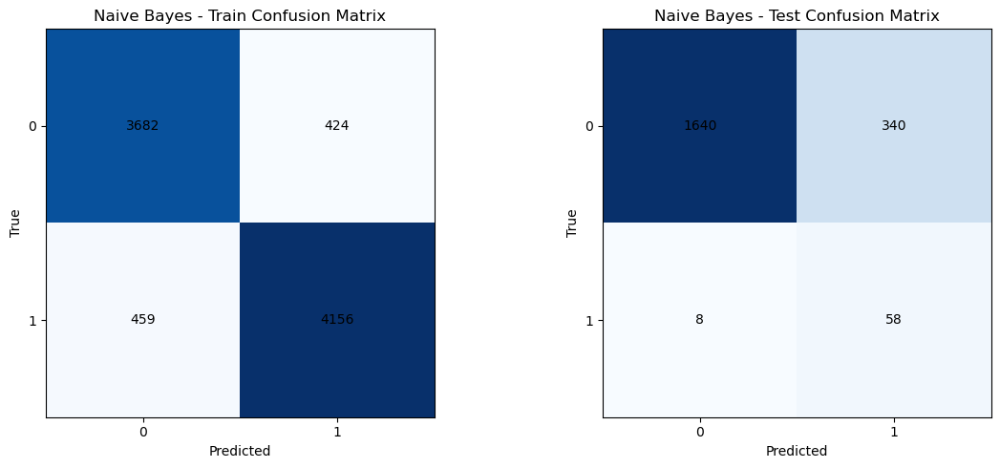

In [868]:
# Confusion Matrices
cm_train = confusion_matrix(y_train_bal, y_pred_train)
cm_test = confusion_matrix(y_test, y_pred_test)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.imshow(cm_train, interpolation='nearest', cmap='Blues')
ax1.set_title('Naive Bayes - Train Confusion Matrix')
ax1.set_xlabel('Predicted')
ax1.set_ylabel('True')
ax1.set_xticks([0, 1])
ax1.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax1.text(j, i, cm_train[i, j], ha='center', va='center', color='black')
ax2.imshow(cm_test, interpolation='nearest', cmap='Blues')
ax2.set_title('Naive Bayes - Test Confusion Matrix')
ax2.set_xlabel('Predicted')
ax2.set_ylabel('True')
ax2.set_xticks([0, 1])
ax2.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax2.text(j, i, cm_test[i, j], ha='center', va='center', color='black')
plt.tight_layout()
plt.show()

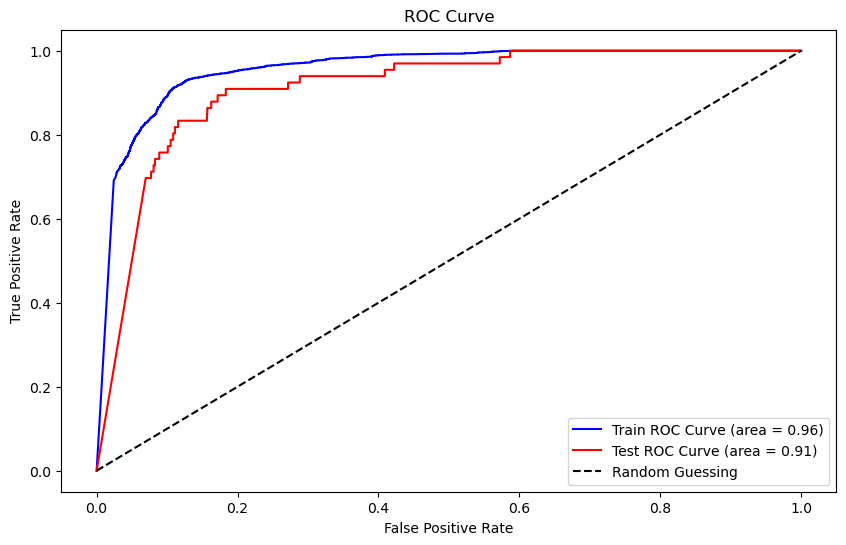

In [869]:
#roc curve
fpr_train, tpr_train, _ = roc_curve(y_train_bal, y_proba_train)
fpr_test, tpr_test, _ = roc_curve(y_test, y_proba_test)
plt.figure(figsize=(10, 6))
plt.plot(fpr_train, tpr_train, label='Train ROC Curve (area = {:.2f})'.format(roc_auc_score(y_train_bal, y_proba_train)), color='blue')
plt.plot(fpr_test, tpr_test, label='Test ROC Curve (area = {:.2f})'.format(roc_auc_score(y_test, y_proba_test)), color='red')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guessing')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [870]:
#cv score
cv_score = cross_val_score(model, X_train_bal, y_train_bal, cv=5, scoring='f1_macro')
print(f"Cross-Validation F1 Score: {cv_score.mean():.4f} ± {cv_score.std():.4f}")

Cross-Validation F1 Score: 0.8983 ± 0.0091


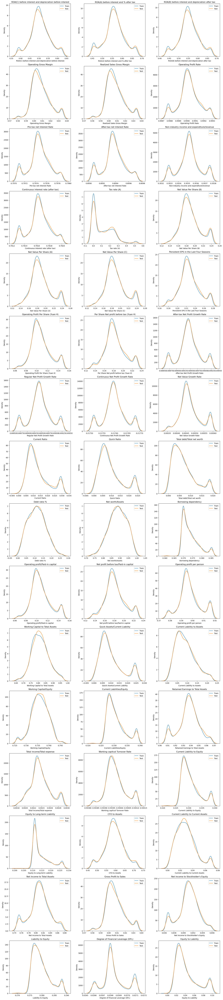

In [871]:
cols = 3
rows = (len(X_train.columns) + cols - 1) // cols  # Ceiling logic without math.ceil

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

# Plot KDE for each feature in both train and test sets
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(X_train.columns):
            axes[r, c].axis('off')  # Hide unused subplots
            continue
        col = X_train.columns[i]
        ax = axes[r, c]
        sns.kdeplot(X_train[col], label='Train', ax=ax)
        sns.kdeplot(X_test[col], label='Test', ax=ax)
        ax.set_title(col)
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()

Model 5: Decision Tree

In [872]:
# Decision Tree - Grid Search
model = DecisionTreeClassifier(random_state=42)
param_grid = {'max_depth': [3, 5], 'min_samples_leaf': [5, 10], 'ccp_alpha': [0.01, 0.1]}
grid = GridSearchCV(model, param_grid, cv=5, scoring='f1_macro')
grid.fit(X_train_bal, y_train_bal)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'ccp_alpha': [0.01, 0.1], 'max_depth': [3, 5],
                         'min_samples_leaf': [5, 10]},
             scoring='f1_macro')

In [873]:
print("Grid Search Results:")
print(pd.DataFrame(grid.cv_results_)[['param_max_depth', 'param_min_samples_leaf', 'param_ccp_alpha', 'mean_test_score']])
print("Best Parameters:", grid.best_params_)


Grid Search Results:
   param_max_depth  param_min_samples_leaf  param_ccp_alpha  mean_test_score
0                3                       5             0.01         0.910089
1                3                      10             0.01         0.910089
2                5                       5             0.01         0.910433
3                5                      10             0.01         0.910433
4                3                       5             0.10         0.848209
5                3                      10             0.10         0.848209
6                5                       5             0.10         0.848209
7                5                      10             0.10         0.848209
Best Parameters: {'ccp_alpha': 0.01, 'max_depth': 5, 'min_samples_leaf': 5}


In [874]:

# Train with best parameters
model = DecisionTreeClassifier(
    max_depth=grid.best_params_['max_depth'],
    min_samples_leaf=grid.best_params_['min_samples_leaf'],
    ccp_alpha=grid.best_params_['ccp_alpha'],
    random_state=42
)
model.fit(X_train_bal, y_train_bal)

DecisionTreeClassifier(ccp_alpha=0.01, max_depth=5, min_samples_leaf=5,
                       random_state=42)

In [875]:

# Evaluation
y_pred_train = model.predict(X_train_bal)
y_pred_test = model.predict(X_test_scaled)
y_proba_train = model.predict_proba(X_train_bal)[:, 1]
y_proba_test = model.predict_proba(X_test_scaled)[:, 1]

In [876]:
# Metrics
print("\nDecision Tree - Train Metrics:")
print(f"Accuracy: {accuracy_score(y_train_bal, y_pred_train):.4f}")
print(f"Precision (Class 0): {precision_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_train_bal, y_proba_train):.4f}")




Decision Tree - Train Metrics:
Accuracy: 0.9146
Precision (Class 0): 0.9526
Recall (Class 0): 0.8614
F1-Score (Class 0): 0.9047
Precision (Class 1): 0.8864
Recall (Class 1): 0.9619
F1-Score (Class 1): 0.9226
ROC-AUC: 0.9332


In [877]:
print("\nDecision Tree - Test Metrics:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_test):.4f}")
print(f"Precision (Class 0): {precision_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_test, y_proba_test):.4f}")


Decision Tree - Test Metrics:
Accuracy: 0.7972
Precision (Class 0): 0.9949
Recall (Class 0): 0.7944
F1-Score (Class 0): 0.8835
Precision (Class 1): 0.1247
Recall (Class 1): 0.8788
F1-Score (Class 1): 0.2185
ROC-AUC: 0.8569


In [878]:
# Classification Reports
print("\nDecision Tree - Train Classification Report:")
print(classification_report(y_train_bal, y_pred_train))
print("\nDecision Tree - Test Classification Report:")
print(classification_report(y_test, y_pred_test))


Decision Tree - Train Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.86      0.90      4106
           1       0.89      0.96      0.92      4615

    accuracy                           0.91      8721
   macro avg       0.92      0.91      0.91      8721
weighted avg       0.92      0.91      0.91      8721


Decision Tree - Test Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.79      0.88      1980
           1       0.12      0.88      0.22        66

    accuracy                           0.80      2046
   macro avg       0.56      0.84      0.55      2046
weighted avg       0.97      0.80      0.86      2046



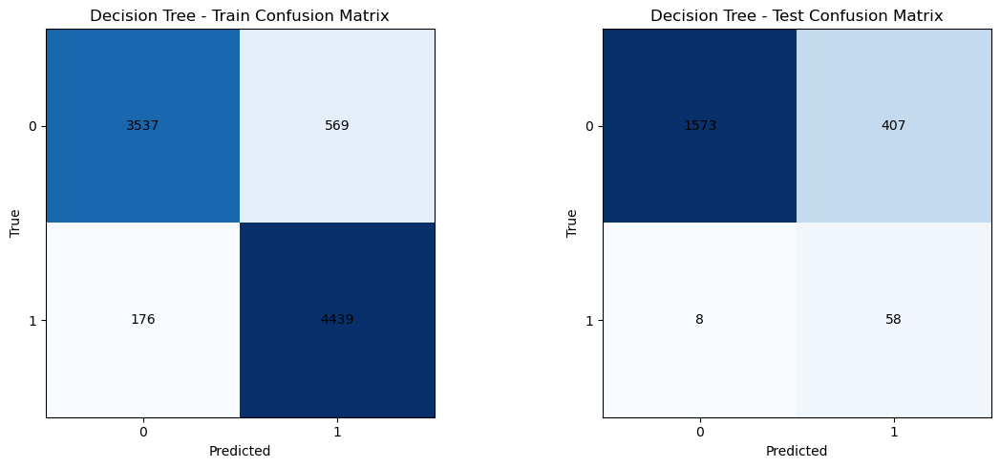

In [879]:
# Confusion Matrices
cm_train = confusion_matrix(y_train_bal, y_pred_train)
cm_test = confusion_matrix(y_test, y_pred_test)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.imshow(cm_train, interpolation='nearest', cmap='Blues')
ax1.set_title('Decision Tree - Train Confusion Matrix')
ax1.set_xlabel('Predicted')
ax1.set_ylabel('True')
ax1.set_xticks([0, 1])
ax1.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax1.text(j, i, cm_train[i, j], ha='center', va='center', color='black')
ax2.imshow(cm_test, interpolation='nearest', cmap='Blues')
ax2.set_title('Decision Tree - Test Confusion Matrix')
ax2.set_xlabel('Predicted')
ax2.set_ylabel('True')
ax2.set_xticks([0, 1])
ax2.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax2.text(j, i, cm_test[i, j], ha='center', va='center', color='black')
plt.tight_layout()
plt.show()

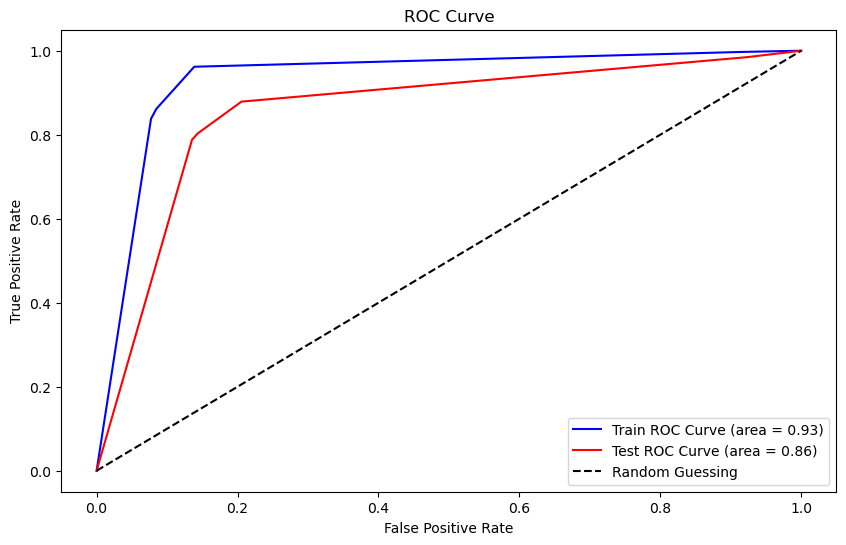

In [880]:
#roc curve
fpr_train, tpr_train, _ = roc_curve(y_train_bal, y_proba_train)
fpr_test, tpr_test, _ = roc_curve(y_test, y_proba_test)
plt.figure(figsize=(10, 6))
plt.plot(fpr_train, tpr_train, label='Train ROC Curve (area = {:.2f})'.format(roc_auc_score(y_train_bal, y_proba_train)), color='blue')
plt.plot(fpr_test, tpr_test, label='Test ROC Curve (area = {:.2f})'.format(roc_auc_score(y_test, y_proba_test)), color='red')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guessing')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [881]:
#cv score
cv_score = cross_val_score(model, X_train_bal, y_train_bal, cv=5, scoring='f1_macro')
print(f"Cross-Validation F1 Score: {cv_score.mean():.4f} ± {cv_score.std():.4f}")

Cross-Validation F1 Score: 0.9104 ± 0.0074


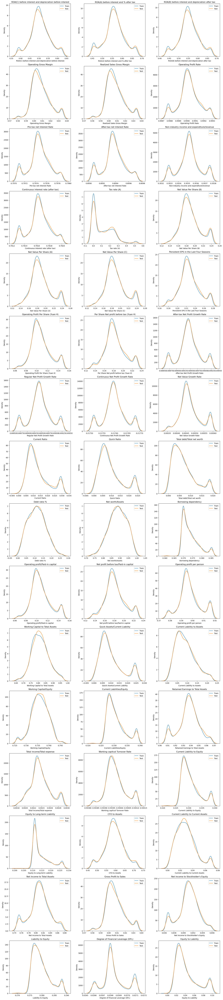

In [882]:
cols = 3
rows = (len(X_train.columns) + cols - 1) // cols  # Ceiling logic without math.ceil

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

# Plot KDE for each feature in both train and test sets
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(X_train.columns):
            axes[r, c].axis('off')  # Hide unused subplots
            continue
        col = X_train.columns[i]
        ax = axes[r, c]
        sns.kdeplot(X_train[col], label='Train', ax=ax)
        sns.kdeplot(X_test[col], label='Test', ax=ax)
        ax.set_title(col)
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()

Model 6: Random Forest

In [883]:
# Random Forest - Grid Search
model = RandomForestClassifier(random_state=42)
param_grid = {'n_estimators': [50, 100], 'max_depth': [3, 5], 'min_samples_leaf': [5, 10]}
grid = GridSearchCV(model, param_grid, cv=5, scoring='f1_macro')
grid.fit(X_train_bal, y_train_bal)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
             param_grid={'max_depth': [3, 5], 'min_samples_leaf': [5, 10],
                         'n_estimators': [50, 100]},
             scoring='f1_macro')

In [884]:
print("Grid Search Results:")
print(pd.DataFrame(grid.cv_results_)[['param_n_estimators', 'param_max_depth', 'param_min_samples_leaf', 'mean_test_score']])
print("Best Parameters:", grid.best_params_)

Grid Search Results:
   param_n_estimators  param_max_depth  param_min_samples_leaf  \
0                  50                3                       5   
1                 100                3                       5   
2                  50                3                      10   
3                 100                3                      10   
4                  50                5                       5   
5                 100                5                       5   
6                  50                5                      10   
7                 100                5                      10   

   mean_test_score  
0         0.928564  
1         0.929018  
2         0.928564  
3         0.929018  
4         0.947022  
5         0.946673  
6         0.947259  
7         0.947025  
Best Parameters: {'max_depth': 5, 'min_samples_leaf': 10, 'n_estimators': 50}


In [885]:
# Train with best parameters
model = RandomForestClassifier(
    n_estimators=grid.best_params_['n_estimators'],
    max_depth=grid.best_params_['max_depth'],
    min_samples_leaf=grid.best_params_['min_samples_leaf'],
    random_state=42
)
model.fit(X_train_bal, y_train_bal)

RandomForestClassifier(max_depth=5, min_samples_leaf=10, n_estimators=50,
                       random_state=42)

In [886]:
# Evaluation
y_pred_train = model.predict(X_train_bal)
y_pred_test = model.predict(X_test_scaled)
y_proba_train = model.predict_proba(X_train_bal)[:, 1]
y_proba_test = model.predict_proba(X_test_scaled)[:, 1]

In [887]:
# Metrics
print("\nRandom Forest - Train Metrics:")
print(f"Accuracy: {accuracy_score(y_train_bal, y_pred_train):.4f}")
print(f"Precision (Class 0): {precision_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_train_bal, y_pred_train, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_train_bal, y_pred_train, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_train_bal, y_proba_train):.4f}")


Random Forest - Train Metrics:
Accuracy: 0.9534
Precision (Class 0): 0.9570
Recall (Class 0): 0.9435
F1-Score (Class 0): 0.9502
Precision (Class 1): 0.9504
Recall (Class 1): 0.9623
F1-Score (Class 1): 0.9563
ROC-AUC: 0.9920


In [888]:
print("\nRandom Forest - Test Metrics:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_test):.4f}")
print(f"Precision (Class 0): {precision_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Recall (Class 0): {recall_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"F1-Score (Class 0): {f1_score(y_test, y_pred_test, pos_label=0):.4f}")
print(f"Precision (Class 1): {precision_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"Recall (Class 1): {recall_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"F1-Score (Class 1): {f1_score(y_test, y_pred_test, pos_label=1):.4f}")
print(f"ROC-AUC: {roc_auc_score(y_test, y_proba_test):.4f}")


Random Forest - Test Metrics:
Accuracy: 0.8715
Precision (Class 0): 0.9948
Recall (Class 0): 0.8717
F1-Score (Class 0): 0.9292
Precision (Class 1): 0.1833
Recall (Class 1): 0.8636
F1-Score (Class 1): 0.3024
ROC-AUC: 0.9373


In [889]:
# Classification Reports
print("\nRandom Forest - Train Classification Report:")
print(classification_report(y_train_bal, y_pred_train))
print("\nRandom Forest - Test Classification Report:")
print(classification_report(y_test, y_pred_test))


Random Forest - Train Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.94      0.95      4106
           1       0.95      0.96      0.96      4615

    accuracy                           0.95      8721
   macro avg       0.95      0.95      0.95      8721
weighted avg       0.95      0.95      0.95      8721


Random Forest - Test Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.87      0.93      1980
           1       0.18      0.86      0.30        66

    accuracy                           0.87      2046
   macro avg       0.59      0.87      0.62      2046
weighted avg       0.97      0.87      0.91      2046



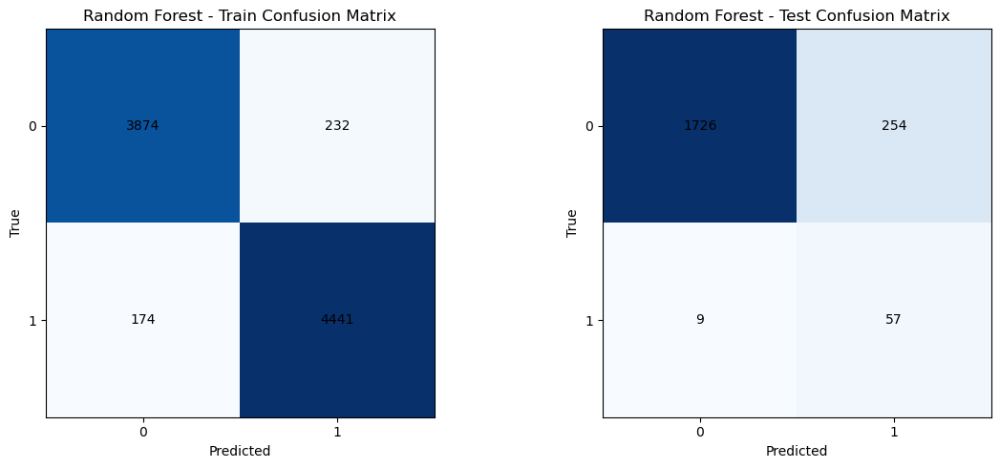

In [890]:
# Confusion Matrices
cm_train = confusion_matrix(y_train_bal, y_pred_train)
cm_test = confusion_matrix(y_test, y_pred_test)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.imshow(cm_train, interpolation='nearest', cmap='Blues')
ax1.set_title('Random Forest - Train Confusion Matrix')
ax1.set_xlabel('Predicted')
ax1.set_ylabel('True')
ax1.set_xticks([0, 1])
ax1.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax1.text(j, i, cm_train[i, j], ha='center', va='center', color='black')
ax2.imshow(cm_test, interpolation='nearest', cmap='Blues')
ax2.set_title('Random Forest - Test Confusion Matrix')
ax2.set_xlabel('Predicted')
ax2.set_ylabel('True')
ax2.set_xticks([0, 1])
ax2.set_yticks([0, 1])
for i in range(2):
    for j in range(2):
        ax2.text(j, i, cm_test[i, j], ha='center', va='center', color='black')
plt.tight_layout()
plt.show()

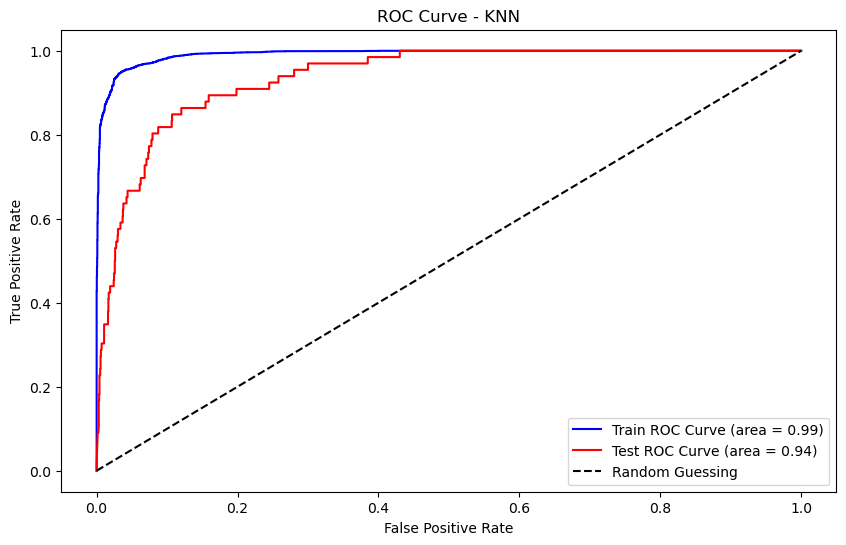

In [891]:
#roc curve
fpr_train, tpr_train, _ = roc_curve(y_train_bal, y_proba_train)
fpr_test, tpr_test, _ = roc_curve(y_test, y_proba_test)
plt.figure(figsize=(10, 6))
plt.plot(fpr_train, tpr_train, label='Train ROC Curve (area = {:.2f})'.format(roc_auc_score(y_train_bal, y_proba_train)), color='blue')
plt.plot(fpr_test, tpr_test, label='Test ROC Curve (area = {:.2f})'.format(roc_auc_score(y_test, y_proba_test)), color='red')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guessing')
plt.title('ROC Curve - KNN')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [892]:
#cv score
cv_score = cross_val_score(model, X_train_bal, y_train_bal, cv=5, scoring='f1_macro')
print(f"Cross-Validation F1 Score: {cv_score.mean():.4f} ± {cv_score.std():.4f}")

Cross-Validation F1 Score: 0.9473 ± 0.0038


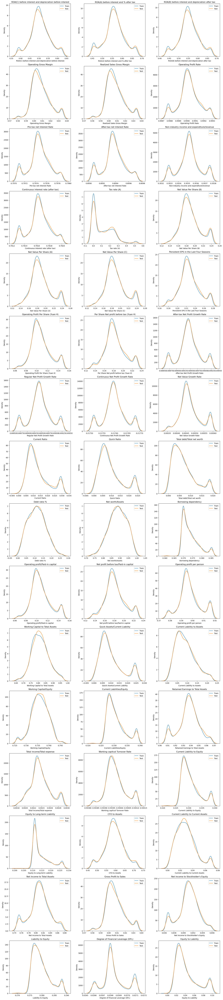

In [893]:
cols = 3
rows = (len(X_train.columns) + cols - 1) // cols  # Ceiling logic without math.ceil

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

# Plot KDE for each feature in both train and test sets
i = 0
for r in range(rows):
    for c in range(cols):
        if i >= len(X_train.columns):
            axes[r, c].axis('off')  # Hide unused subplots
            continue
        col = X_train.columns[i]
        ax = axes[r, c]
        sns.kdeplot(X_train[col], label='Train', ax=ax)
        sns.kdeplot(X_test[col], label='Test', ax=ax)
        ax.set_title(col)
        ax.legend()
        i += 1

plt.tight_layout()
plt.show()

Conclusion

In [894]:
#Initialize models
models = {
    "Logistic Regression": LogisticRegression(),
    "SVM": SVC(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Naive Bayes": GaussianNB(),
    "KNN": KNeighborsClassifier()
}

In [895]:
#Train and evaluate each model using cross-validation
results = {}
for model_name, model in models.items():
    # Cross-validation score
    cv_scores = cross_val_score(model, X_train_scaled, y_train, cv=5, scoring='accuracy')
    
    # Store results (mean of cross-validation scores)
    results[model_name] = cv_scores.mean()

In [896]:
#Print classification report for each model on test data
for model_name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)
    print(f"\n{model_name} Classification Report:")
    print(classification_report(y_test, y_pred))


Logistic Regression Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1980
           1       0.50      0.23      0.31        66

    accuracy                           0.97      2046
   macro avg       0.74      0.61      0.65      2046
weighted avg       0.96      0.97      0.96      2046


SVM Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1980
           1       0.00      0.00      0.00        66

    accuracy                           0.97      2046
   macro avg       0.48      0.50      0.49      2046
weighted avg       0.94      0.97      0.95      2046


Decision Tree Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.97      0.97      1980
           1       0.24      0.27      0.26        66

    accuracy                           0.95      2046
   macro avg      

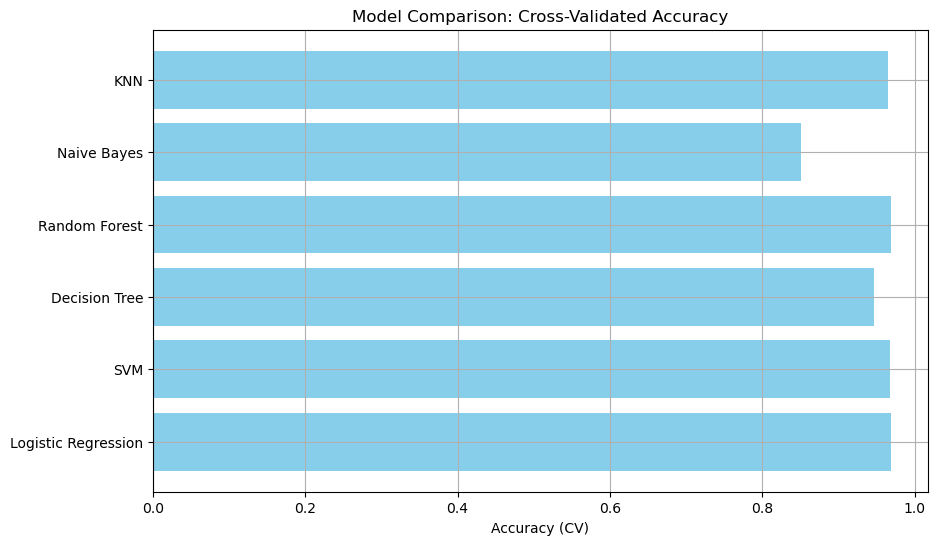

In [897]:
#Plot the accuracy of all models
model_names = list(results.keys())
accuracies = list(results.values())

plt.figure(figsize=(10, 6))
plt.barh(model_names, accuracies, color='skyblue')
plt.xlabel('Accuracy (CV)')
plt.title('Model Comparison: Cross-Validated Accuracy')
plt.grid(True)
plt.show()

In [898]:
#Identify the best model
best_model_name = max(results, key=results.get)
best_model_accuracy = results[best_model_name]
print(f"\nThe best performing model is: {best_model_name} with cross-validated accuracy: {best_model_accuracy:.2%}")


The best performing model is: Random Forest with cross-validated accuracy: 96.88%
